In [1]:
import numpy as np
import cv2
import os.path as osp
from glob import glob
import matplotlib.pyplot as plt
from IPython.core.debugger import set_trace
from skimage.feature import hog
from skimage import exposure, draw
import matplotlib.lines as mlines
plt.rcParams.update({'figure.max_open_warning': 0})

def load_image(path):
  im = cv2.imread(path)
  im = im[:, :, ::-1]  # BGR -> RGB
  im = im.astype(np.float32)  # for vlfeat functions
  return im

def report_accuracy(confidences, label_vector):
  """
  Calculates various accuracy metrics on the given predictions
  :param confidences: 1D numpy array holding predicted confidence scores
  :param label_vector: 1D numpy array holding ground truth labels (same size
  as confidences
  :return: tp_rate, fp_rate, tn_rate, fn_rate
  """
  preds = confidences.copy()
  preds[preds >= 0] = 1
  preds[preds <  0] = -1

  tp = np.logical_and(preds > 0, preds==label_vector)
  fp = np.logical_and(preds > 0, preds!=label_vector)
  tn = np.logical_and(preds < 0, preds==label_vector)
  fn = np.logical_and(preds < 0, preds!=label_vector)

  N = len(label_vector)

  tp_rate = sum(tp) / (sum(tp)+sum(fn)) * 100
  fp_rate = sum(fp) / (sum(fp)+sum(tn)) * 100
  tn_rate = 100 - fp_rate
  fn_rate = 100 - tp_rate
  accuracy = (sum(tp)+sum(tn)) / N * 100

  print('Accuracy = {:4.3f}%\n'
        'True Positive rate = {:4.3f}%\nFalse Positive rate = {:4.3f}%\n'
        'True Negative rate = {:4.3f}%\nFalse Negative rate = {:4.3f}%'.
    format(accuracy, tp_rate, fp_rate, tn_rate, fn_rate))

  return tp_rate, fp_rate, tn_rate, fn_rate

def voc_ap(rec, prec):
  mrec = np.hstack((0, rec, 1))
  mpre = np.hstack((0, prec, 0))

  for i in reversed(range(len(mpre)-1)):
    mpre[i] = max(mpre[i], mpre[i+1])

  i = np.where(mrec[1:] != mrec[:-1])[0] + 1
  ap = sum((mrec[i] - mrec[i-1]) * mpre[i])
  return ap

def evaluate_detections(bboxes, confidences, image_ids, label_path, draw=True):
  """
  :param bboxes:
  :param confidences:
  :param image_ids:
  :param label_path:
  :param draw:
  :return:
  """
  gt_ids = []
  gt_bboxes = []
  with open(label_path, 'r') as f:
    for line in f:
      gt_id, xmin, ymin, xmax, ymax = line.split(' ')
      gt_ids.append(gt_id)
      gt_bboxes.append([float(xmin), float(ymin), float(xmax), float(ymax)])
  gt_bboxes = np.vstack(gt_bboxes)

  npos = len(gt_ids)
  gt_isclaimed = np.asarray([False]*len(gt_ids))


  # sort detections by decreasing confidence
  order = np.argsort(-confidences)
  confidences = confidences[order]
  image_ids = [image_ids[i] for i in order]
  bboxes = bboxes[order]

  # assign detections to GT objects
  nd = len(confidences)
  tp = np.asarray([False]*nd)
  fp = np.asarray([False]*nd)
  duplicate_detections = np.asarray([False]*nd)

  for d in range(nd):
    cur_gt_ids = [i for i, gt_id in enumerate(gt_ids) if gt_id == image_ids[d]]

    bb = bboxes[d]
    ovmax = -float('inf')

    for j in cur_gt_ids:
      bbgt = gt_bboxes[j]
      bi = [max(bb[0], bbgt[0]), max(bb[1], bbgt[1]), min(bb[2], bbgt[2]),
            min(bb[3], bbgt[3])]
      iw = bi[2] - bi[0] + 1
      ih = bi[3] - bi[1] + 1

      if (iw > 0) and (ih > 0):
        ua = (bb[2]-bb[0]+1) * (bb[3]-bb[1]+1) +\
             (bbgt[2]-bbgt[0]+1) * (bbgt[3]-bbgt[1]+1) -\
             iw*ih
        ov = iw*ih / ua
        if ov > ovmax:
          ovmax = ov
          jmax = j

    if ovmax >= 0.3:
      if not gt_isclaimed[jmax]:
        tp[d] = True
        gt_isclaimed[jmax] = True
      else:
        fp[d] = True
        duplicate_detections[d] = True
    else:
      fp[d] = True

  cum_fp = np.cumsum(fp)
  cum_tp = np.cumsum(tp)
  rec = cum_tp / npos
  prec = cum_tp / (cum_tp + cum_fp)
  ap = voc_ap(rec, prec)

  if draw:
    plt.figure()
    plt.plot(rec, prec, '-')
    plt.xlim(0, 1)
    plt.ylim(0, 1)
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Average precision = {:4.3f}'.format(ap))

    plt.figure()
    plt.plot(cum_fp, rec, '-')
    plt.xlim(0, 300)
    plt.ylim(0, 1)
    plt.xlabel('False Positives')
    plt.ylabel('Number of correct detections (recall)')
    plt.title('This figure is meant to match Fig. 6 in Viola-Jones')

  order = np.argsort(order)
  tp = tp[order]
  fp = fp[order]
  duplicate_detections = duplicate_detections[order]

  return gt_ids, gt_bboxes, gt_isclaimed, tp, fp, duplicate_detections

def visualize_detections_by_image(bboxes, confidences, image_ids, tp, fp,
    test_scn_path, label_filename, onlytp=False):
  """
  Visuaize the detection bounding boxes and ground truth on images
  :param bboxes: N x 4 numpy matrix, where N is the number of detections. Each
  row is [xmin, ymin, xmax, ymax]
  :param confidences: size (N, ) numpy array of detection confidences
  :param image_ids: N-element list of image names for each detection
  :param tp: size (N, ) numpy array of true positive indicator variables
  :param fp: size (N, ) numpy array of false positive indicator variables
  :param test_scn_path: path to directory holding test images (in .jpg format)
  :param label_filename: path to .txt file containing labels. Format is
  image_id xmin ymin xmax ymax for each row
  :param onlytp: show only true positives
  :return:
  """
  gt_ids = []
  gt_bboxes = []
  with open(label_filename, 'r') as f:
    for line in f:
      gt_id, xmin, ymin, xmax, ymax = line.split(' ')
      gt_ids.append(gt_id)
      gt_bboxes.append([float(xmin), float(ymin), float(xmax), float(ymax)])
  gt_bboxes = np.vstack(gt_bboxes)

  gt_file_list = list(set(gt_ids))

  for gt_file in gt_file_list:
    cur_test_image = load_image(osp.join(test_scn_path, gt_file))

    cur_gt_detections = [i for i, gt_id in enumerate(gt_ids) if gt_id == gt_file]
    cur_gt_bboxes = gt_bboxes[cur_gt_detections]

    cur_detections = [i for i, gt_id in enumerate(image_ids) if gt_id == gt_file]
    cur_bboxes = bboxes[cur_detections]
    cur_confidences = confidences[cur_detections]
    cur_tp = tp[cur_detections]
    cur_fp = fp[cur_detections]


    plt.figure()
    plt.imshow(cur_test_image.astype(np.uint8))

    for i, bb in enumerate(cur_bboxes):
      if cur_tp[i]:  # true positive
        plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'g')
      elif cur_fp[i]:  # false positive
        if not onlytp:
          plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'r')
      else:
        raise AssertionError

    for bb in cur_gt_bboxes:
      plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'y')

    plt.axis("off")
    plt.title('{:s} (green=true pos, red=false pos, yellow=ground truth), '
              '{:d}/{:d} found'.format(gt_file, sum(cur_tp), len(cur_gt_bboxes)))

def visualize_detections_by_confidence(bboxes, confidences, image_ids,
    test_scn_path, label_filename, onlytp=False):
  """
  Visuaize the detection bounding boxes and ground truth on images, sorted by
  confidence
  :param bboxes: N x 4 numpy matrix, where N is the number of detections. Each
  row is [xmin, ymin, xmax, ymax]
  :param confidences: size (N, ) numpy array of detection confidences
  :param image_ids: N-element list of image names for each detection
  :param test_scn_path: path to directory holding test images (in .jpg format)
  :param label_filename: path to .txt file containing labels. Format is
  image_id xmin ymin xmax ymax for each row
  :param onlytp: show only true positives
  :return:
  """
  gt_ids = []
  gt_bboxes = []
  with open(label_filename, 'r') as f:
    for line in f:
      gt_id, xmin, ymin, xmax, ymax = line.split(' ')
      gt_ids.append(gt_id)
      gt_bboxes.append([float(xmin), float(ymin), float(xmax), float(ymax)])
  gt_bboxes = np.vstack(gt_bboxes)

  # sort detections by decreasing confidence
  order = np.argsort(-confidences)
  image_ids = [image_ids[i] for i in order]
  bboxes = bboxes[order]
  confidences = confidences[order]

  for d in range(len(confidences)):
    cur_gt_idxs = [i for i, gt_id in enumerate(gt_ids) if gt_id == image_ids[d]]
    bb = bboxes[d]
    ovmax = -float('inf')

    for j in cur_gt_idxs:
      bbgt = gt_bboxes[j]
      bi = [max(bb[0], bbgt[0]), max(bb[1], bbgt[1]), min(bb[2], bbgt[2]),
            min(bb[3], bbgt[3])]
      iw = bi[2] - bi[0] + 1
      ih = bi[3] - bi[1] + 1

      if (iw > 0) and (ih > 0):
        ua = (bb[2]-bb[0]+1) * (bb[3]-bb[1]+1) +\
             (bbgt[2]-bbgt[0]+1) * (bbgt[3]-bbgt[1]+1) -\
             iw*ih
        ov = iw*ih / ua
        if ov > ovmax:
          ovmax = ov
          jmax = j

    if onlytp and ovmax < 0.3:
      continue

    im = load_image(osp.join(test_scn_path, image_ids[d]))
    plt.figure()
    plt.imshow(im.astype(np.uint8))
    if ovmax >= 0.3:
      bbgt = gt_bboxes[jmax]
      plt.plot(bbgt[[0, 2, 2, 0, 0]], bbgt[[1, 1, 3, 3, 1]], 'y')
      plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'g')
    else:
      plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'r')
    plt.title('Image {:s} [{:d}/{:d}], (green=true pos, red=false pos, '
              'yellow=ground truth)'.format(image_ids[d], d, len(confidences)))


def visualize_detections_by_image_no_gt(bboxes, confidences, image_ids,
    test_scn_path):
  """
  Visualize detection bounding boxes on images that don't have ground truth
  labels
  :param bboxes: N x 4 numpy matrix, where N is the number of detections. Each
  row is [xmin, ymin, xmax, ymax]
  :param confidences: size (N, ) numpy array of detection confidences
  :param image_ids: N-element list of image names for each detection
  :param test_scn_path: path to directory holding test images (in .jpg format)
  :return:
  """
  test_filenames = glob(osp.join(test_scn_path, '*.png'))

  for im_filename in test_filenames:
    test_id = im_filename.split('/')[-1]
    test_id = test_id.split('\\')[-1] # in case the file path use backslash
    cur_test_image = load_image(im_filename)
    cur_detections = [i for i, im_id in enumerate(image_ids) if im_id == test_id]
    cur_bboxes = bboxes[cur_detections]
    cur_confidences = confidences[cur_detections]

    #plt.figure()
    plt.imshow(cur_test_image.astype(np.uint8))
    
    for bb in cur_bboxes:
      plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'g')
    plt.title('{:s} green=detection'.format(test_id))
    plt.show()

In [2]:
import os
import utils
import matplotlib.pyplot as plt

positive_train_data_path = './INRIAPerson/96X160H96/Train/pos/'
positive_data_list = os.listdir(positive_train_data_path)
#print(data_list)

negative_train_data_path = './INRIAPerson/Train/neg/'
negative_data_list = os.listdir(negative_train_data_path)
#print(data_list)


Test_data_path = './INRIAPerson/Test/pos/'
test_data_list = os.listdir(Test_data_path)

hog_positive_already = True
hog_negative_already = True

In [3]:
ssgcale_list = []
location_list = []
for i in range(12,65):
    if i%4 == 0 or i%6 == 0:
        ssgcale = [[i,i],[i,i*2]]
        if i < 33:
            ssgcale.append([i*2,i])
        ssgcale_list.append(ssgcale)
k = 0
for i in ssgcale_list:
    for j in i:
        [x,y] = [j[0],j[1]]
        sx , sy = 4,4
        
        if x > 32 and x%8==0:
            sx = 8
        elif x%6==0:
            sx = 6
            
        if y > 32 and y%8==0:
            sy = 8
        elif y%6==0:
            sxy= 6
            
        
        for location_y in range(int((128-y)/sy)+1):
            for location_x in range(int(((64-x)/sx)+1)):
                k +=1
                xmin = location_x*sx
                ymin = location_y*sy
                xmax = location_x*sx + x - 1
                ymax = location_y*sy + y - 1
                location_list.append([xmin,xmax,ymin,ymax])

In [4]:
print(location_list[0])
new_list = []
ik = 0 
for v in location_list:
    j = False
    ik = ik + 1
    jk = 0
    for k in new_list:
        same = True
        jk = jk + 1
        for i in range(4):
            if v[i]!=k[i]:
        
                #if i!=0:
                    #print(i)
                same = False
                break
        
        if  same:
            j = True
            
            print(ik,jk)
            print('ssibal')
    if not j:
        new_list.append(v)
    
    
print(len(new_list))

[0, 11, 0, 11]
4997


In [5]:
import pickle
import concurrent.futures
#from threading import thread
from multiprocessing import Process, Queue
import threading

def positive_1(location_list,positive_data_list,positive_train_data_path,num,number):
    k = 0
    for location in location_list:
        #print(location)
        #print(num)
        k = k +1
        
        
        pos_hog= []
        if k%number==num:
            #print(k)
            #print("complted featuer num : ",end = "")
            print(k)
            for image in positive_data_list:
                path = positive_train_data_path +image
                train_img = cv2.imread(path)
                train_img = train_img[16:16+128,16:16+64]
                train_img = cv2.cvtColor(train_img, cv2.COLOR_BGR2GRAY)
                [xmin,xmax,ymin,ymax] = location
                #print(location)
                train_img_crop = train_img[ymin:ymax+1,xmin:xmax+1]
                size = (xmax-xmin+1,ymax-ymin+1)
                ssize = ((xmax-xmin+1)//2,(ymax-ymin+1)//2)
                hog = cv2.HOGDescriptor(size,size,(1,1),ssize,9)
                features = hog.compute(train_img_crop,(8,8),(0,0))
                #print(len(featue))
                pos_hog.append(features.flatten())

                if(len(features)!=36):
                    print('warning')
            #print(len(pos_hog))
            with open(f'./hog_features2/positive_feature_{k}.pkl', 'wb') as f:
                pickle.dump(pos_hog, f)

#positive_1(location_list,positive_data_list,positive_train_data_path,1)


if not hog_positive_already:
    thread = []
    for i in range(24):
        th = threading.Thread(target = positive_1,args=(location_list,positive_data_list,positive_train_data_path,i,24))
        thread.append(th)
    for i in range(24):
        thread[i].start()
    for i in range(24):
        thread[i].join()
    hog_positive_already = True

In [6]:
import pickle
import concurrent.futures
#from threading import thread
from multiprocessing import Process, Queue
import threading
import random

sampling_rate = 10
#to make negative positive ratio 1 to 10
#negative 1218 * 20 ~= 2416*10 g
def negative_1(location_list,negativetive_data_list,negative_train_data_path,num,number,sampling_rate):
    k = 0
    for location in location_list:
        #print(location)
        k = k +1
        
        neg_hog= []
        if k%number==num:
            print(k)
            for image in negative_data_list:
                path = negative_train_data_path + image
                train_img = cv2.imread(path)
                [y,x,z] = train_img.shape
                for sampling in range(sampling_rate):
                    #print(negative_train_data_path)
                    #print(image)


                    rand_x = random.randrange(0,x - 64)
                    rand_y = random.randrange(0,y - 128)
                    #print([x,y,z])
                    sampled_img = train_img[rand_y:rand_y + 128, rand_x :rand_x + 64,:]
                    #print([rand_x,rand_y])
                    #print(sampled_img.shape)
                    sampled_img = cv2.cvtColor(sampled_img, cv2.COLOR_BGR2GRAY)
                    [xmin,xmax,ymin,ymax] = location
                    #print(location)
                    train_img_crop = sampled_img[ymin:ymax+1,xmin:xmax+1]
                    size = (xmax-xmin+1,ymax-ymin+1)
                    ssize = ((xmax-xmin+1)//2,(ymax-ymin+1)//2)
                    hog = cv2.HOGDescriptor(size,size,(1,1),ssize,9)
                    features = hog.compute(train_img_crop,(8,8),(0,0))
                    #print(len(featue))
                    neg_hog.append(features.flatten())

                    if(len(features)!=36):
                        print('warning')
                #print(len(pos_hog))
            with open(f'./hog_features_negative/negative_feature_{k}.pkl', 'wb') as f:
                pickle.dump(neg_hog, f)
#executor = concurrent.futures.ThreadPoolExecutor(max_workers=10)
#executor.submit(negative_1(location_list,negative_data_list,negative_train_data_path,0,2,20))
#executor.submit(positive_1(location_list,positive_data_list,positive_train_data_path,1,2,20))

if not hog_negative_already:
    thread = []
    for i in range(24):
        th = threading.Thread(target = negative_1,args=(location_list,negative_data_list,negative_train_data_path,i,24,10))
        thread.append(th)
    for i in range(24):
        thread[i].start()
    for i in range(24):
        thread[i].join()
    hog_negative_already = True

In [7]:
import random

index_list = [] 
feature_index = rand_x = random.randrange(0,4997)
for i in range(250): 
    while feature_index in index_list: 
        feature_index = random.randrange(0,4997)
    index_list.append(feature_index)
    
index_list.sort()

In [8]:
from sklearn import metrics
def svmfitter(positive_f,negative_f,lenN,accuracy_list,prediction_list,clf_list,i,lc,error):
    #negative_f = negative_f[0:lenN]
    #oddlist=all_list[0::2]
    if lc <4:
        negative_f = negative_f[lc::4]
        
    a = np.ones(len(positive_f))    
    b = np.zeros(len(negative_f))
    truth = np.concatenate((a, b), axis=0)
    clf = svm.LinearSVC(max_iter = 10000)
    
    if len(error)!=0:
        error = [abs(number) for number in error] #+ 0.05 * np.ones(len(error))
        clf.fit(np.concatenate((positive_f, negative_f), axis=0), truth, sample_weight = error)
    else:
        clf.fit(np.concatenate((positive_f, negative_f), axis=0), truth)
    prediction = clf.predict(np.concatenate((positive_f, negative_f), axis=0))
    accuracy = metrics.accuracy_score(truth,prediction)
    
    
    #positive_calls = (len(positive_f) - np.sum(prediction[0:len(positive_f)]))/2
    #accuracy = np.sum(prediction[0:len(positive_f)])/len(positive_f)
    
    accuracy_list[i] = accuracy
    prediction_list[i] = prediction[0:len(positive_f)]
    clf_list[i] = clf
    

def multisvm(index_list,lenN,lc,negative_filter,error):
    best_acc = 0
    error_value = None
    for iter in (range(len(index_list)//10)):#5
        
        
        #iter += 1
        #print(iter/len(index_list))
        accuracy_list = [0,0,0,0,0,0,0,0,0,0]
        prediction_list = [0,0,0,0,0,0,0,0,0,0]
        clf_list = [0,0,0,0,0,0,0,0,0,0]
        thread = []
        for i in range(10):

            with open(f'./hog_features2/positive_feature_{index_list[iter * 10 + i]}.pkl', 'rb') as f:
                positive_f = pickle.load(f)
            with open(f'./hog_features_negative/negative_feature_{index_list[iter * 10 + i]}.pkl', 'rb') as f:
                negative_f = pickle.load(f)
            for j in range(len(negative_filter)):
                tmp = []
                for k in range(len(negative_filter[j])):
                    if negative_filter[j][k] == True:
                        tmp.append(negative_f[k])
                negative_f = tmp
            
            
            
            th = threading.Thread(target = svmfitter,args=(positive_f,negative_f,lenN,accuracy_list,prediction_list,clf_list,i,lc,error))
            thread.append(th)
        for i in range(10):
            thread[i].start()
        for i in range(10):
            thread[i].join()
        for i in range(10):
            if accuracy_list[i]>best_acc:
                best_acc = accuracy_list[i]
                best_clf = clf_list[i]
                best_pred = prediction_list[i]
                best_location_index = index_list[iter * 10 + i]
        print(best_acc)
        print(iter*20 + 20,end="")
        print("% finished")
        #print(accuracy_list)
    return best_acc,best_clf,best_pred,best_location_index

In [9]:
Ftarget = 0.01
dmin = 0.9975
fmax = 0.7
from sklearn.preprocessing import normalize

already_calculated = True
D = 1
F = 1
lc = 10
F_list = [1]
D_list = [1]
clf_layer = []
threshold_list = []
selected_list = []

negative_filter = []
negative_filter.append(np.ones(len(negative_data_list)*20, dtype=bool))

Neg = list(range(len(negative_data_list)*20))

lenN = 5000

negative_train_data_path = './INRIAPerson/Train/neg/'
negative_data_list = os.listdir(negative_train_data_path)
negative_check_list = (np.ones(len(negative_data_list)*20, dtype=bool))
from sklearn import svm
if not already_calculated:
    while F_list[-1]>Ftarget:

        fi = 1
        lc += 1
        clf_layer.append([])
        error = []

        while fi > fmax:



            print("sterat")
            clf_layer[-1].append([])
            index_list = [] 


            for i in range(50): #samepleing svm
                feature_index = random.randrange(1,4997)
                while feature_index in selected_list:
                    feature_index = random.randrange(1,4997)
                index_list.append(feature_index)


            index_list.sort()


            best_acc = 0
            best_clf = None
            best_pred = []
            iter = 0

            best_acc,best_clf,best_pred,best_location_index = multisvm(index_list,lenN,lc,negative_filter,error)
            #best_clf 



            if best_acc != 1:
                weight  = (0.5*np.log(1/(1-best_acc) - 1))
            else:
                weight = 1
            #print(weight)
            clf_layer[-1][-1] = [best_clf,weight,best_location_index]
            selected_list.append(best_location_index)



            total_prob = None
            total_prob2 = None
            wk =None
            w_m = 1
            for i in range(len(clf_layer[-1])):


                curr_clf,curr_weight,z     = clf_layer[-1][i]


                with open(f'./hog_features2/positive_feature_{z}.pkl', 'rb') as f:
                    positive_f = pickle.load(f)
                with open(f'./hog_features_negative/negative_feature_{z}.pkl', 'rb') as f:
                    negative_f = pickle.load(f)



                #print("ssibal",end = ' ')
                #print (accuracy)


                for j in range(len(negative_filter)):
                    tmp = []
                    for k in range(len(negative_filter[j])):
                        if negative_filter[j][k] == True:
                            tmp.append(negative_f[k])
                    negative_f = tmp


                #print(curr_weight)

                positive_f_np = np.asarray(positive_f)
                #prob = np.dot(positive_f_np,curr_clf.coef_.transpose())+curr_clf.intercept_
                prob = curr_clf.predict(positive_f)
                #prob = curr_clf.predict_prob(positive_f)
                #for i in range(len(prob)):
                #    if(prob[i][0]<-3):
                #        prob[i][0]=-3

                #wk.append(curr_weight)
                prob *= curr_weight
                #prob = prob[:,1]

                a = np.ones(len(positive_f))
                b = np.zeros(len(negative_f))
                truth = np.concatenate((a, b), axis=0)

                if total_prob is None:
                    total_prob = prob
                    wk = curr_weight*a
                else:
                    wk += curr_weight*a
                    total_prob += prob
                w_m = w_m *curr_weight

                negative_f_np = np.asarray(negative_f)
                #prob2 = np.dot(negative_f_np,curr_clf.coef_.transpose())+curr_clf.intercept_
                prob2 = curr_clf.predict(negative_f)

                #for i in range(len(prob2)):
                #    if(prob2[i][0]<-3):
                #        prob2[i][0]=-3
                #wk *= curr_weight
                prob2 *= curr_weight
                #prob2 = prob2[:,1]
                if total_prob2 is None:
                    total_prob2 = prob2
                else:
                    total_prob2 += prob2

                if i == len(clf_layer[-1]) - 1:
                    prob2_tmp = total_prob2

                    #true_value = (np.concatenate((wk  , np.zeros(len(prob2_tmp))), axis=0)) * curr_weight
                    #error = (np.concatenate((total_prob, total_prob2_tmp), axis=0) - true_value ) 
                    true_value = (np.concatenate((wk  , np.zeros(len(prob2_tmp))), axis=0))
                    if lc <4:
                        prob2_tmp = prob2_tmp[lc::4]
                        #true_value = (np.concatenate((wk  , np.zeros(len(prob2_tmp))), axis=0)) * curr_weight
                        true_value = (np.concatenate((wk  , np.zeros(len(prob2_tmp))), axis=0))

                    error = (np.concatenate((total_prob, prob2_tmp), axis=0).flatten() - true_value  )

                    #error = error - min(error)
                    #(data - np.min(data)) / (np.max(data) - np.min(data))

                    error = np.square(error)   


                    error = (error - np.min(error))/(np.max(error) - np.min(error))            
            sample_accuracy = 0
            threshold = 4
            tmp = -1

            counter = 0
            for i in total_prob:
                if (i==0):
                    counter += 1
            print('wde')
            print(counter)
            while sample_accuracy < dmin:
                right = 0
                threshold -= 0.001
                for i in range(len(positive_f)):
                    if total_prob[i]>threshold:
                        right += 1
                #

                sample_accuracy = right/len(positive_f)
                if sample_accuracy!=tmp:
                    tmp = sample_accuracy
                    print(sample_accuracy)
            right2 = 0
            right3 = 0

            for i in range(len(negative_f)):
                if total_prob2[i]>threshold :
                    right2 += 1 #false positive
                    if i%4 == lc:
                        right3 + 1
            fi = right2/len(negative_f)
            #if lc<4:
                #fi = right3/len(negative_f)*4
            print("thershold")
            print(threshold)
            print(fi)    

        list_of_continue = ([total_prob2>threshold])
        negative_filter.append(list_of_continue[0].flatten())
        k = 0
        l = 0



        F_list.append(F_list[-1]*fi)
        D_list.append(D_list[-1]*dmin)
        threshold_list.append(threshold)
        print("phase done")
        print(threshold)
        print(fi)    
    with open(f'./clf_layer.pkl', 'wb') as f:
        pickle.dump(clf_layer, f)    
    with open(f'./threshold_list.pkl', 'wb') as f:
        pickle.dump(threshold_list, f)    

In [29]:
with open(f'./clf_layer.pkl', 'rb') as f:
    clf_layer = pickle.load( f)    
with open(f'./threshold_list.pkl', 'rb') as f:
    threshold_list = pickle.load(f)    
#print(F_list)# = [1]
#print(D_list)# = [1]
#print(clf_layer) #= []
#print(threshold_list)# = []
#print(selected_list) #= []

import multiprocessing



def cascade_1lyaer(predict,best_clf,weight,best_location_index,location_list):
    [xmin,xmax,ymin,ymax] =  location_list[best_location_index]
    #print(xmin,xmax,ymin,ymax)
    cropped = img[ymin:ymax+1,xmin:xmax+1]
    size = (xmax-xmin+1,ymax-ymin+1)
    ssize = ((xmax-xmin+1)//2,(ymax-ymin+1)//2)

    hog = cv2.HOGDescriptor(size,size,(1,1),ssize,9)
    #print('test')
    features = hog.compute(cropped,(8,8),(0,0))
    #print('test')
    predict_tmp = best_clf.predict([features.flatten()])
    predict_tmp *= weight
    predict += predict_tmp


def detect_cascade(threshold_list,selected_list,clf_layer,img): 
    #128 64 가 들어왔다고 할 때
    human = True
    for layer in range(len(threshold_list)):
        thresh = threshold_list[layer]
        predict = 0
        for i in range(len(clf_layer[layer])):
            [best_clf,weight,best_location_index] = clf_layer[layer][i] 
            
            [xmin,xmax,ymin,ymax] =  location_list[best_location_index]
            #print(xmin,xmax,ymin,ymax)
            cropped = img[ymin:ymax+1,xmin:xmax+1]
            size = (xmax-xmin+1,ymax-ymin+1)
            ssize = ((xmax-xmin+1)//2,(ymax-ymin+1)//2)
            
            hog = cv2.HOGDescriptor(size,size,(1,1),ssize,9)
            #print('test')
            features = hog.compute(cropped,(8,8),(0,0))
            #print('test')
            predict_tmp = best_clf.predict([features.flatten()])
            predict_tmp *= weight
            predict += predict_tmp
        if(predict<thresh):
            return False ,False
    return human ,predict

In [102]:
import numpy as np
import multiprocessing
ssgcale_list = [1,1.1,1.2,1.3,1.4,1.5,1.75,1.9,2,2.1,2.25,2.5,2.6,2.75,3,3.2,3.4,3.6,3.8,4,4.2,4.5]

hog = cv2.HOGDescriptor()
detect_list = []
detect_list_ssg = []
threshold = 0.1
k =1
a = len(test_data_list)


def thread_dectec(threshold_list,selected_list,clf_layer,cropped_gray,s,i,j):
    human, prob = detect_cascade(threshold_list,selected_list,clf_layer,cropped_gray)
    if human and prob>min(12/s,9):
        
            coordi = [i,j,prob,s]
            detect_list[-1].append(coordi)

for imgpath in test_data_list:
    detect_list.append([])
    detect_list_ssg.append([])
    img = cv2.imread('./INRIAPerson/Test/pos/'+imgpath)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))

    [y,x] = gray.shape
    print(k/a)
    k = k+1

    ssgy = (y/128)
    ssgx = (x/64)
    ssgcale_list = []
    ssgm = max(ssgy,ssgx)
    sk = 1
    while sk<ssgm:
        ssgcale_list.append(sk)
        sk = sk * 1.25
    ssgcale_list.append(sk)
    thread =[]
    for s in ssgcale_list:
        if int(x/s)>64 and int(y/s)>128:
            gray_tmp = cv2.resize(gray, dsize=(int(x/s), int(y/s)))
            [ys,xs] = gray_tmp.shape
            
            
            
            for i in range(int((ys - 128)/16) ):
                
                for j in range(int((xs - 64)/8) ):
                    
                    cropped_gray = gray_tmp[i*16:i*16+128,j*8:j*8+64]
                    human, prob = detect_cascade(threshold_list,selected_list,clf_layer,cropped_gray)
                    #print('test')
                    #print(human)
                    if human and prob>12/s:
                            #print(prob)
                            coordi = [i,j,prob]
                            detect_list_ssg[-1].append(s)
                            detect_list[-1].append(coordi)
    #break
    print(len(detect_list[-1]))
with open('detection_list_2.pickle', 'wb') as f:
    pickle.dump(detect_list, f)
with open('detection_list_prob_2.pickle', 'wb') as f:
    pickle.dump(detect_list_ssg, f)

0.003472222222222222
23
0.006944444444444444
14
0.010416666666666666
90
0.013888888888888888
13
0.017361111111111112
1
0.020833333333333332


KeyboardInterrupt: 

In [110]:
with open('detection_list_2.pickle', 'rb') as f:
    detect_list = pickle.load(f)
with open('detection_list_prob_2.pickle', 'rb') as f:
    detect_list_prob = pickle.load(f)

k_total = 0
detect_list_boolean = []#np.ones((len(detect_list),len(detect_list[0])), dtype=bool)
#for i in range(len(detect_list)):
#    detect_list[i].sort(key=lambda x: x[2])
    
#if not already_calculated:
for iter in range(len(detect_list)):
    k = 0
    k_total += len(detect_list[iter])
    detect_list_boolean.append(np.ones((len(detect_list[iter])), dtype=bool))
    for i in range(len(detect_list[iter])):
        #print(detect_list[iter][i][2])
        for j in range(len(detect_list[iter])):
            l = j 
            if(l!=i):
                if detect_list_boolean[iter][i] == True and detect_list_boolean[iter][l] == True:
                    l = j

                    ssgcale = detect_list[iter][i][3]
                    xmin1 = detect_list[iter][i][1]*ssgcale*8 
                    ymin1 = detect_list[iter][i][0]*ssgcale*16 
                    xmax1 = detect_list[iter][i][1]*ssgcale*8 + ssgcale*64
                    ymax1 = detect_list[iter][i][0]*ssgcale*16 + ssgcale*128

                    ssgcale2 = detect_list[iter][l][3]
                    xmin2 = detect_list[iter][l][1]*ssgcale2*8 
                    ymin2 = detect_list[iter][l][0]*ssgcale2*16 
                    xmax2 = detect_list[iter][l][1]*ssgcale2*8 + ssgcale2*64
                    ymax2 = detect_list[iter][l][0]*ssgcale2*16 + ssgcale2*128
                    #print(i,l)
                    #print(xmin1,xmax1,ymin1,ymax1)
                    #print(xmin2,xmax2,ymin2,ymax2)

                    inter_x = min(xmax2,xmax1) - max(xmin1,xmin2)
                    inter_y = min(ymax2,ymax1) - max(ymin1,ymin2)
                    if inter_x>0 and inter_y>0:
                        #print('test')
                        area1 = (xmax1 - xmin1)*(ymax1 - ymin1)
                        area2 = (xmax2 - xmin2)*(ymax2 - ymin2)

                        duplicate_ratio = inter_x*inter_y/(area1 + area2 - inter_x*inter_y)
                        if  duplicate_ratio > 0.3:
                            k_total -= 1
                            k = k + 1
                            #detect_list[iter][i] = 0
                            if(detect_list[iter][i][2]<detect_list[iter][l][2]) :
                                detect_list_boolean[iter][i]=(False)
                            else:
                                detect_list_boolean[iter][l]=(False)
                        
                        elif inter_x == xmax1 - xmin1 and inter_y == ymax1 - ymin1:
                            #print('test')
                            detect_list_boolean[iter][i]=(False)
                            k_total -= 1
                        elif inter_x == xmax2 - xmin2 and inter_y == ymax2 - ymin2:
                            detect_list_boolean[iter][l]=(False)
                            k_total -= 1
                        #elif   xmin2 < (xmax1 + xmin1)/2 < xmax2 and ymin2 < (ymax1 + ymin1)/2 < ymax2:
                        #    detect_list_boolean[iter][i]=(False)
                        #    k_total -= 1
                #if detect_list_boolean[iter][i] == True :
                    #if(detect_list[iter][i][2] < 30/ssgcale**2):
                        #detect_list_boolean[iter][i]=(False)
                        #k_total -= 1
    imgpath = test_data_list[iter]
    #print(imgpath)
    #img = cv2.imread('./INRIAPerson/Test/pos/'+imgpath)
    #gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    #plt.imshow(gray,cmap="gray")
    #plt.show()
    #print(iter)
    #if len(detect_list[iter])>0:
        #print( k/len(detect_list[iter]))

In [111]:
print(k_total)
bboxes = np.zeros((k_total, 4))
confidences = np.zeros((k_total))
image_ids = []

test_scn_path = './INRIAPerson/Test/pos/'
k = 0

for iter in range(len(detect_list)):
    tmp_bboxes = []
    for i in range(len(detect_list[iter])):
        if detect_list_boolean[iter][i] == True:
            
            ssgcale = detect_list[iter][i][3]
            
            xmin1 = detect_list[iter][i][1]*ssgcale*8 
            ymin1 = detect_list[iter][i][0]*ssgcale*16 
            xmax1 = detect_list[iter][i][1]*ssgcale*8 + ssgcale*64
            ymax1 = detect_list[iter][i][0]*ssgcale*16 + ssgcale*128
            
            image_ids.append(test_data_list[iter])
            bboxes[k] = np.array([xmin1,ymin1,xmax1,ymax1])
            confidences[k] = detect_list[iter][i][2]
            
            k = k + 1

804


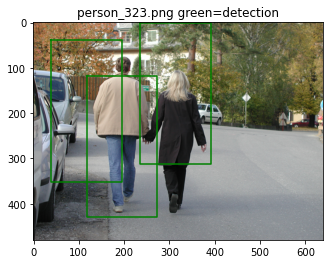

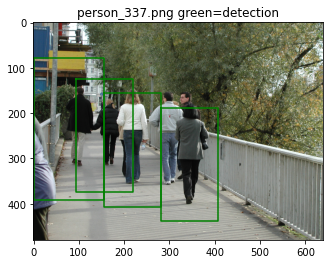

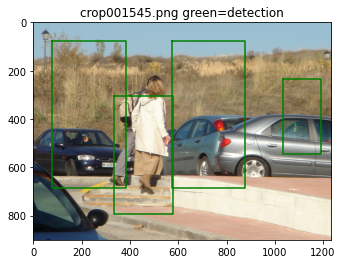

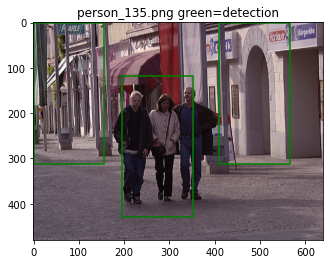

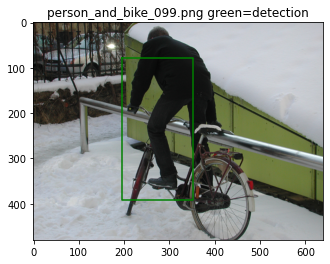

...

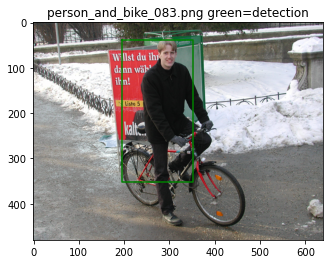

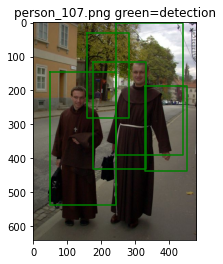

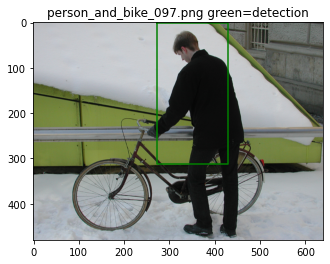

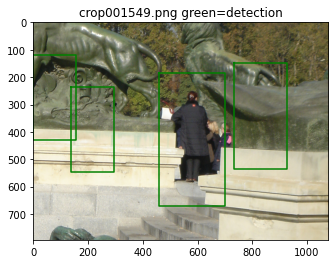

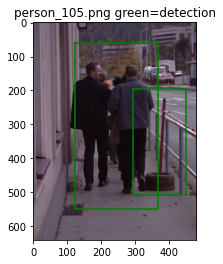

In [ ]:
visualize_detections_by_image_no_gt(bboxes,confidences,image_ids,test_scn_path)

(['crop001501.png',
  'crop001501.png',
  'crop001501.png',
  'crop001501.png',
  'crop001504.png',
  'crop001504.png',
  'crop001511.png',
  'crop001512.png',
  'crop001512.png',
  'crop001512.png',
  'crop001514.png',
  'crop001514.png',
  'crop001514.png',
  'crop001520.png',
  'crop001520.png',
  'crop001521.png',
  'crop001521.png',
  'crop001521.png',
  'crop001521.png',
  'crop001521.png',
  'crop001521.png',
  'crop001522.png',
  'crop001522.png',
  'crop001522.png',
  'crop001531.png',
  'crop001531.png',
  'crop001533.png',
  'crop001533.png',
  'crop001533.png',
  'crop001533.png',
  'crop001533.png',
  'crop001544.png',
  'crop001544.png',
  'crop001545.png',
  'crop001546.png',
  'crop001546.png',
  'crop001549.png',
  'crop001555.png',
  'crop001555.png',
  'crop001555.png',
  'crop001555.png',
  'crop001555.png',
  'crop001566.png',
  'crop001566.png',
  'crop001573.png',
  'crop001573.png',
  'crop001573.png',
  'crop001573.png',
  'crop001573.png',
  'crop001574.png',


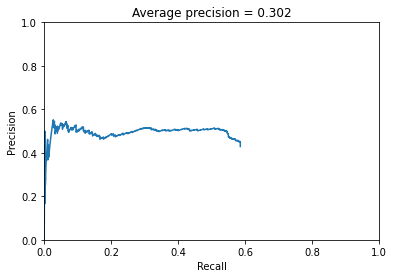

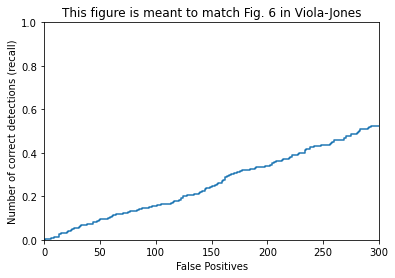

In [113]:
#label_path = '/Users/park/Desktop/vision_project/test_result.pkl'
label_path = './test2.txt'

evaluate_detections(bboxes,confidences,image_ids, label_path)

In [98]:
for i in range(len(clf_layer)):
    for i in range(len(clf_layer[i])):
        

8
3
5
5
6
4
5
4
17
4
7
